<a href="https://colab.research.google.com/github/borysknysh/codes/blob/master/SID_training_tf2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [12]:
! pip install rawpy
%load_ext tensorboard

In [2]:
import tensorflow as tf
import numpy as np
import abc
import pathlib
import rawpy
from random import randint, random
import matplotlib.pyplot as plt
from functools import lru_cache
import time
import cv2
import os
import pandas as pd
import pickle
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
import datetime

In [4]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [5]:
! ls gdrive/MyDrive/Sony_val/

original_sony_patches.pkl  self_normalized_sony_patches.pkl  Sony_val_list.txt
processed		   Sony				     trainings
result.csv		   sony_patches.pkl


In [3]:
### Writing dataset utilities
def write_dataset_as_separate_pickles(generator, 
                   patches_per_image,
                   crop_func,
                   n_images, 
                   normalization, 
                   path_to_df):
  min_log, max_log = normalization
  df = pd.DataFrame()
  processed = f"{os.path.dirname(path_to_df)}/processed"
  os.makedirs(processed, exist_ok = True)
  print(processed)
  for im_id in range(n_images):
    in_tensor, gt_tensor = next(generator)
    in_tensor_log = (np.log(in_tensor+1e-6)-min_log) / (max_log-min_log)
    for patch_id in range(patches_per_image):
      in_tensor_log_cropped, gt_tensor_cropped = crop_func(in_tensor_log, gt_tensor)
      input_file_path = f'{processed}/input_{im_id}_{patch_id}.pkl'
      gt_file_path = f'{processed}/gt_{im_id}_{patch_id}.pkl'
      with open(input_file_path, 'wb') as f:
        pickle.dump(in_tensor_log_cropped, f)
      with open(gt_file_path, 'wb') as f:
        pickle.dump(gt_tensor_cropped, f)
      df = df.append({"input": input_file_path, "gt": gt_file_path}, ignore_index = True)
  df.to_csv(path_to_df, index = False)

def input_log_transform(in_tensor):
  return np.log(in_tensor+1e-6)

def input_transform(in_tensor):
  return in_tensor

def input_log_self_normalized(in_tensor):
  out = input_log_transform(in_tensor)
  min_out = np.min(out)
  max_out = np.max(out)
  return (out-min_out)/(max_out-min_out)

def write_dataset_as_monolite_pickle(generator, 
                                     patches_per_image, 
                                     crop_size, 
                                     n_images,
                                     normalization, 
                                     path_to_pickle,
                                     transform):
  min_in, max_in = normalization
  crop_func = crop_patch(crop_size)
  n_patches = patches_per_image*n_images
  structure = {"input": np.zeros((n_patches, crop_size, crop_size, 4)), 
               "gt": np.zeros((n_patches, crop_size, crop_size, 3)),
               "normalization": normalization}
  for im_id in range(n_images):
    in_tensor, gt_tensor = next(generator)
    in_tensor_log = (transform(in_tensor)-min_in) / (max_in-min_in)
    for patch_id in range(patches_per_image):
      in_tensor_log_cropped, gt_tensor_cropped = crop_func(in_tensor_log, gt_tensor)
      idx = patch_id + patches_per_image*im_id
      structure["input"][idx] = in_tensor_log_cropped
      structure["gt"][idx] = gt_tensor_cropped
  with open(path_to_pickle, 'wb') as f:
      pickle.dump(structure, f)

In [4]:
def get_normalization(generator, transform):
  min_log = 1e300
  max_log = -1e300
  for _ in range(10):
    in_tensor, gt_tensor = next(generator)
    log = transform(in_tensor)
    if min_log > np.min(log):
      min_log = np.min(log)
    if max_log < np.max(log):
      max_log = np.max(log)
    del in_tensor
    del gt_tensor
  return min_log, max_log

def crop_patch(crop_size):
  def crop(image_input, image_gt):
    assert image_gt.shape[0] == image_input.shape[0] and image_gt.shape[1] == image_input.shape[1]
    ratio = image_gt.shape[0] // image_input.shape[0]
    H_in, W_in, C_in = image_input.shape
    x_pos_in = randint(0, W_in-crop_size)
    y_pos_in = randint(0, H_in-crop_size)
    image_input = image_input[y_pos_in:y_pos_in+crop_size, x_pos_in:x_pos_in+crop_size, :]
    image_gt = image_gt[ratio*y_pos_in:ratio*(y_pos_in+crop_size), ratio*x_pos_in:ratio*(x_pos_in+crop_size),:]
    return image_input, image_gt
  return crop

class InterfaceDataset(abc.ABC):
  def __init__(self, filelistpath,
               isFlip = True,
               isCrop = False,
               crop_size = 128):
    filelistpath = pathlib.Path(filelistpath)
    self.__folder_path = filelistpath.parent
    self.__isFlip = isFlip
    self.__isCrop = isCrop
    self.__file_list_input, self.__file_list_gt = self.split_input_and_gt(filelistpath)
    self.__crop_func = crop_patch(crop_size)
  @staticmethod
  @abc.abstractmethod
  def split_input_and_gt(filelistpath):
    pass

  @staticmethod
  @abc.abstractmethod
  def read_single_image(img_file):
      pass

  def __len__(self):
      return len(self.__file_list_input)

  
  def __get_training_pair(self, idx):
    input_path = self.__file_list_input[idx]
    gt_path = self.__file_list_gt[idx]
    image_input, image_gt = self.read_single_image(input_path, gt_path) 

    if self.__isCrop:
      crop_size = 128
      image_input, image_gt = self.__crop_func(image_input, image_gt)
    
    if self.__isFlip:
      flip_prob = np.random.rand(2)
      if flip_prob[0] < 0.5:
        image_input = np.fliplr(image_input)
        image_gt = np.fliplr(image_gt)
      if flip_prob[1] < 0.5:
        image_input = np.flipud(image_input)
        image_gt = np.flipud(image_gt)

    return image_input, image_gt

  def get_generator(self):
    length = self.__len__()
    while True:
      idx = randint(0, length-1)
      image_input, image_gt = self.__get_training_pair(idx)
      yield image_input , image_gt



def pack_raw(raw):
    # pack Bayer image to 4 channels
    im = raw.raw_image_visible.astype(np.float32)
    im = np.maximum(im - 512, 0) / (16383 - 512)  # subtract the black level

    im = np.expand_dims(im, axis=2)
    img_shape = im.shape
    H = img_shape[0]
    W = img_shape[1]

    out = np.concatenate((im[0:H:2, 0:W:2, :],
                          im[0:H:2, 1:W:2, :],
                          im[1:H:2, 1:W:2, :],
                          im[1:H:2, 0:W:2, :]), axis=2)
    return out


class SonyDataset(InterfaceDataset):
  @staticmethod
  def split_input_and_gt(filelistpath):
    token = open(filelistpath,'r')
    linestoken=token.readlines()
    input_path = []
    gt_path = []
    prefix_path = filelistpath.parent
    for x in linestoken:
        in_out_pair = x.split()
        input_path.append(prefix_path/'Sony/short'/in_out_pair[0].split('/')[-1])
        gt_path.append(prefix_path/'Sony/long'/in_out_pair[1].split('/')[-1])
    return input_path, gt_path

  @staticmethod
  @lru_cache(maxsize=32)
  def read_single_image(input_img_file, gt_img_file):
    in_exposure = float(str(input_img_file).split('_')[-1].split('s.ARW')[0])
    gt_exposure = float(str(gt_img_file).split('_')[-1].split('s.ARW')[0])
    ratio = min(gt_exposure / in_exposure, 300)
    input_raw = rawpy.imread(str(input_img_file))
    input_image = pack_raw(input_raw) * ratio / 10.
    gt_image = rawpy.imread(str(gt_img_file)).postprocess(use_camera_wb=True, half_size=False, no_auto_bright=True, output_bps=16)
    scale_percent = 50 # percent of original size
    width = int(gt_image.shape[1] * scale_percent / 100)
    height = int(gt_image.shape[0] * scale_percent / 100)
    dim = (width, height)
    gt_image = cv2.resize(gt_image, dim, interpolation = cv2.INTER_AREA)
    gt_image = np.float32(gt_image / 65535.0)
    return input_image, gt_image
  

class PickleDataset(InterfaceDataset):
  @staticmethod
  def split_input_and_gt(filelistpath):
    df = pd.read_csv(filelistpath)
    input_path = []
    gt_path = []
    for _,row in df.iterrows():
        input_path.append(row['input'])
        gt_path.append(row['gt'])
    return input_path, gt_path

  @staticmethod
  @lru_cache(maxsize=2000)
  def read_single_image(input_img_file, gt_img_file):
    with (open(input_img_file, "rb")) as openfile:
      input_image = pickle.load(openfile)
    with (open(gt_img_file, "rb")) as openfile:
      gt_image = pickle.load(openfile)
    return input_image, gt_image

class MonolitePickleDataset(InterfaceDataset):
  @staticmethod
  def split_input_and_gt(filelistpath):
    with (open(filelistpath, "rb")) as openfile:
      structure = pickle.load(openfile)
    input_path = structure["input"]
    gt_path = structure["gt"]
    return input_path, gt_path

  @staticmethod
  def read_single_image(input_img_file, gt_img_file):
    return input_img_file, gt_img_file


class ArtificialMonolitePickleDataset(InterfaceDataset):
  @staticmethod
  def split_input_and_gt(filelistpath):
    with (open(filelistpath, "rb")) as openfile:
      structure = pickle.load(openfile)
    input_path = structure["input"]
    gt_path = structure["gt"]
    return input_path, gt_path

  @staticmethod
  def read_single_image(input_img_file, gt_img_file):
    dark_scale = 10
    sigma = 0.05
    new_input = gt_img_file/dark_scale
    noise = np.random.normal(scale = sigma/dark_scale, size=gt_img_file.shape)
    new_input = np.clip(new_input+noise, 0, 1)
    new_input = input_log_self_normalized(new_input)
    return new_input, gt_img_file

In [5]:
def double_conv_block(x, n_filters):
   # Conv2D then ReLU activation
   x = layers.Conv2D(n_filters, 3, padding = "same", kernel_initializer = "he_normal")(x)
   x = tf.keras.layers.LeakyReLU()(x)
   # Conv2D then ReLU activation
   x = layers.Conv2D(n_filters, 3, padding = "same", kernel_initializer = "he_normal")(x)
   x = tf.keras.layers.LeakyReLU()(x)
   return x

def downsample_block(x, n_filters):
   f = double_conv_block(x, n_filters)
   p = layers.MaxPool2D(2)(f)
   #p = layers.Dropout(0.3)(p)
   return f, p

def upsample_block(x, conv_features, n_filters):
   # upsample
   x = layers.Conv2DTranspose(n_filters, 3, 2, padding="same")(x)
   # concatenate
   x = layers.concatenate([x, conv_features])
   # dropout
   #x = layers.Dropout(0.3)(x)
   # Conv2D twice with ReLU activation
   x = double_conv_block(x, n_filters)
   return x

def build_unet_model():
   # inputs
   downscale_layers_factor = 16
   inputs = layers.Input(shape=(None,None,3))
   # encoder: contracting path - downsample
   # 1 - downsample
   f1, p1 = downsample_block(inputs, 64//downscale_layers_factor)
   # 2 - downsample
   f2, p2 = downsample_block(p1, 128//downscale_layers_factor)
   # 3 - downsample
   f3, p3 = downsample_block(p2, 256//downscale_layers_factor)
   # 4 - downsample
   f4, p4 = downsample_block(p3, 512//downscale_layers_factor)
   # 5 - bottleneck
   bottleneck = double_conv_block(p4, 1024//downscale_layers_factor)
   # decoder: expanding path - upsample
   # 6 - upsample
   u6 = upsample_block(bottleneck, f4, 512//downscale_layers_factor)
   # 7 - upsample
   u7 = upsample_block(u6, f3, 256//downscale_layers_factor)
   # 8 - upsample
   u8 = upsample_block(u7, f2, 128//downscale_layers_factor)
   # 9 - upsample
   u9 = upsample_block(u8, f1, 64//downscale_layers_factor)
   # outputs
   outputs = layers.Conv2D(3, 1, padding="same")(u9)
   # unet model with Keras Functional API
   unet_model = tf.keras.Model(inputs, outputs, name="U-Net")
   return unet_model

def build_stacked_convs():
  inputs = layers.Input(shape=(None,None,3))
  bottleneck = double_conv_block(inputs, 64)
  bottleneck = double_conv_block(bottleneck, 64)
  bottleneck = double_conv_block(bottleneck, 64)
  outputs = layers.Conv2D(3, 1, padding="same")(bottleneck)
  unet_model = tf.keras.Model(inputs, outputs, name="Stacked Convolutions")
  return unet_model

In [6]:
dataset = SonyDataset("gdrive/MyDrive/Sony_val/Sony_val_list.txt")
crop_func = crop_patch(128)
generator = dataset.get_generator()
min_log, max_log = get_normalization(generator, input_log_self_normalized)

KeyboardInterrupt: ignored

In [5]:
write_dataset_as_monolite_pickle(generator, 
                                 150, 
                                 128, 
                                 20, 
                                 (min_log, max_log), 
                                 "gdrive/MyDrive/Sony_val/original_sony_patches.pkl",
                                 input_transform)

NameError: ignored

In [7]:
pickle_dataset = ArtificialMonolitePickleDataset("gdrive/MyDrive/Sony_val/self_normalized_sony_patches.pkl", isFlip=True, isCrop=False)
pickle_generator = pickle_dataset.get_generator()

0.0 1.0


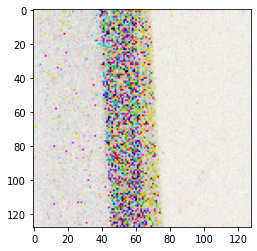

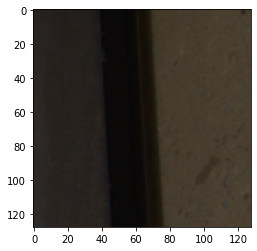

In [9]:
input, gt = next(pickle_generator)
print(np.min(input), np.max(input))
plt.figure()
plt.imshow(input)
plt.figure()
plt.imshow(gt)
plt.show()

In [10]:
train_ds = tf.data.Dataset.from_generator(pickle_dataset.get_generator, output_signature=(
         tf.TensorSpec(shape=(128,128,3), dtype=tf.float32),
         tf.TensorSpec(shape=(128,128,3), dtype=tf.float32)))

train_ds = (
    train_ds
    .batch(8)
    .prefetch(tf.data.AUTOTUNE)
)

In [67]:
logdir = os.path.join("gdrive/MyDrive/Sony_val/trainings/logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
w = tf.summary.create_file_writer(logdir)
for step, (input_batch, gt_batch) in enumerate(train_ds):
  if step%1000 == 0:
    with w.as_default():
      tf.summary.image("Input data", tf.concat([input_batch[:,:,:,:3], gt_batch], axis = 2), step=step, max_outputs=input_batch.shape[0])
  if step > 50_000:
    break

In [13]:
%tensorboard --logdir gdrive/MyDrive/Sony_val/trainings/

<IPython.core.display.Javascript object>

In [ ]:
unet_model = build_unet_model()
loss_fn = tf.keras.losses.MeanSquaredError()
optimizer=tf.keras.optimizers.Adam(learning_rate=3e-5)
logdir = os.path.join("gdrive/MyDrive/Sony_val/trainings/logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
w = tf.summary.create_file_writer(logdir)

In [15]:
for step, (x_batch_train, y_batch_train) in enumerate(train_ds):
    step += 10_000
    with tf.GradientTape() as tape:
        logits = unet_model(x_batch_train, training=True)  # Logits for this minibatch
        loss_value = loss_fn(y_batch_train, logits)
    grads = tape.gradient(loss_value, unet_model.trainable_weights)
    optimizer.apply_gradients(zip(grads, unet_model.trainable_weights))
    if step % 1000 == 0:
      unet_model.save('gdrive/MyDrive/Sony_val/trainings/my_model')
      with w.as_default():
        print(x_batch_train.shape, logits.shape, y_batch_train.shape)
        tf.summary.image("in_gt_out data", 
                         tf.concat([x_batch_train[:,:,:,:3], y_batch_train,logits], axis = 2), 
                         step=step, 
                         max_outputs=x_batch_train.shape[0])
    if step % 200 == 0:
      with w.as_default():
        tf.summary.scalar("Training loss", loss_value, step=step)
      print(
          "Training loss (for one batch) at step %d: %.4f"
          % (step, float(loss_value))
      )
      print("Seen so far: %s samples" % ((step + 1) * x_batch_train.shape[0]))
    if step > 100_000:
      break

INFO:tensorflow:Assets written to: gdrive/MyDrive/Sony_val/trainings/my_model/assets
(8, 128, 128, 3) (8, 128, 128, 3) (8, 128, 128, 3)
Training loss (for one batch) at step 10000: 0.0107
Seen so far: 80008 samples
Training loss (for one batch) at step 10200: 0.0040
Seen so far: 81608 samples
Training loss (for one batch) at step 10400: 0.0113
Seen so far: 83208 samples
Training loss (for one batch) at step 10600: 0.0049
Seen so far: 84808 samples
Training loss (for one batch) at step 10800: 0.0121
Seen so far: 86408 samples
INFO:tensorflow:Assets written to: gdrive/MyDrive/Sony_val/trainings/my_model/assets
(8, 128, 128, 3) (8, 128, 128, 3) (8, 128, 128, 3)
Training loss (for one batch) at step 11000: 0.0053
Seen so far: 88008 samples
Training loss (for one batch) at step 11200: 0.0081
Seen so far: 89608 samples
Training loss (for one batch) at step 11400: 0.0059
Seen so far: 91208 samples
Training loss (for one batch) at step 11600: 0.0079
Seen so far: 92808 samples
Training loss (fo

In [44]:
unet_model.summary()

Model: "Stacked Convolutions"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_5 (InputLayer)        [(None, None, None, 4)]   0         
                                                                 
 conv2d_58 (Conv2D)          (None, None, None, 64)    2368      
                                                                 
 leaky_re_lu_18 (LeakyReLU)  (None, None, None, 64)    0         
                                                                 
 conv2d_59 (Conv2D)          (None, None, None, 64)    36928     
                                                                 
 leaky_re_lu_19 (LeakyReLU)  (None, None, None, 64)    0         
                                                                 
 conv2d_60 (Conv2D)          (None, None, None, 64)    36928     
                                                                 
 leaky_re_lu_20 (LeakyReLU)  (None, None, None

In [16]:
dataset = SonyDataset("gdrive/MyDrive/Sony_val/Sony_val_list.txt")
generator = dataset.get_generator()

In [17]:
input, gt = next(generator)

In [18]:
gt.shape

(1424, 2128, 3)

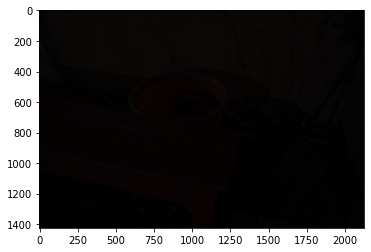

In [61]:
dark_scale = 10
sigma = 0.04
new_input = gt/dark_scale
noise = np.random.normal(scale = sigma/dark_scale, size=gt.shape)
new_input = np.clip(new_input+noise, 0, 1)
plt.figure()
plt.imshow(new_input)
cv2.imwrite("gdrive/MyDrive/Sony_val/input.png", 255*new_input)
new_input = input_log_self_normalized(new_input)

In [55]:
output = unet_model(new_input[None,])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True

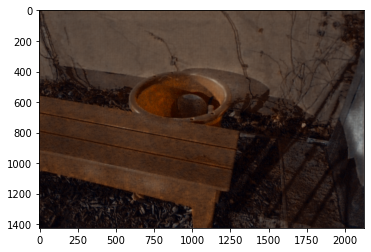

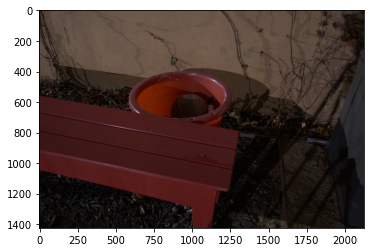

In [62]:
plt.figure()
plt.imshow(output[0])
cv2.imwrite("gdrive/MyDrive/Sony_val/output.png", 255*output[0].numpy())
plt.figure()
plt.imshow(gt)
cv2.imwrite("gdrive/MyDrive/Sony_val/GT.png", 255*gt)

In [59]:
np.max(gt)

1.0